## Making a N-Body motion

### Import the packages

In [1]:
import sympy as smp 
import numpy as np 
import matplotlib.pyplot as plt 
from scipy import integrate
from matplotlib import animation
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import PillowWriter
from matplotlib.colors import LinearSegmentedColormap
from IPython.display import HTML

### The overview

Newton's law of gravity $F = ma = GMm/r^2$ and hence $a = GM/r^2$. For a collection of masses, written in terms of vector calculus:

$$\frac{d^2 \vec{r}_i}{dt^2} = \sum_{j \neq i} \frac{Gm_j}{r_{ij}^3} \vec{r}_{ij} $$

where $\vec{r}_i$ and $m_i$ is the location and mass of the ith particle, and $\vec{r}_{ij} = \vec{r}_j - \vec{r}_i$ (the tail of this vector is at $\vec{r}_i$ and points to $\vec{r}_j$).

Dimensions for this problem are gross $G = 6.67 \times 10^{-11}$ too small for efficient computation on computer. Convert to dimensionless quantities:

$$\frac{d^2 \vec{r}_i'}{dt'^2} = \sum_{j \neq i} \frac{m_j'}{r_{ij}'^3} \vec{r}_{ij}' $$

where

* $\vec{r}_i' = \vec{r}_i / L$ and $\vec{r}_{ij}' = \vec{r}_{ij} / L$ where $L$ is some characteristic length of the problem
* $m_i' = m_i / M$ where $M$ is some characteristic length of the problem
* $t' = t\sqrt{GM/L^3}$ where $M$ and $L$ are the characteristic length and mass.

We will drop the primes for the rest of this code, assuming everything is dimensionless. We can solve for the motion of the object, as a function of dimensionless time $t'$ and then solve for $t$ using 

$$ t = t' \sqrt{L^3 / GM}$$

Note that any second order ODE

$$\frac{d^2 y}{dt^2} = F\left(y, \frac{dy}{dt}, t\right) $$

can be rewritten as two coupled first order ODEs when defining $v_y = dy/dt$

$$ \frac{dy}{dt} = v_y $$
$$ \frac{dv_y}{dt} = F\left(y, v_y, t\right) $$

So we define our system of things we need to solve for as 

$$\vec{S} = (x_1, y_1, x_2, y_2, v_{x1}, v_{y1}, v_{x2}, v_{y2})$$

and we need to write in a function that takes in $S$ and returns $d\vec{S}/dt$

* https://arxiv.org/pdf/1709.04775.pdf

These two papers look at the three body problem under the following configuraton:

* $m_1 = m_2 = 1$. $m_3$ can vary
* At $t=0$ the initial conditions $x_1 = -x_2 = -1 $  and $x_3 = 0$ 
* At $t=0$ the initial conditions $y_1 = y_2 = y_3 = 0$
* At $t=0$ the initial conditions $v_{x1} = v_{x2} = v_1$ where $v_1$ is some defined speed
* At $t=0$ the initial conditions $v_{y1} = v_{y2} = v_2$ where $v_2$ is some defined speed
* At $t=0$ the initial conditions $v_{x3} = -2 v_1 / m_3$ and $v_{y3} = -2v_2 / m_3$

Thus the only parameters that are altered are $m_3$, $v_1$, and $v_2$. **These are states with zero angular momentum**. 

See Table I from paper 1 and Table I from paper 2 for interesting stable configurations (hard to find!). Here are two I found:

1. From last row of Table I paper 2: $v_1 = 0.9911981217$, $v_2 = 0.7119472124$, and $m_3 = 4$
2. From second row of Table I paper 1: $v_1=0.39295$, $v_2 = 0.09758$ and $m_3=1$

### Making the code to solve the 3 body problem properly 

In [23]:
# PARARMS TO CHANGE
m3 = 1
v1 = 0.4101378717
v2 = 0.1341894173
time_span =  20 * 1

# Everything else follows from paper
m1 = 1
m2 = 1 
m3 = m3
x1_0 = -1
y1_0 = 0
x2_0 = 1
y2_0 = 0
x3_0 = 0
y3_0 = 0
vx1_0 =  v1
vy1_0 =  v2
vx2_0 = v1
vy2_0 = v2
vx3_0 = -2*v1/m3
vy3_0 = -2*v2/m3

def dSdt(t, S):
    x1, y1, x2, y2, x3, y3, vx1, vy1, vx2, vy2, vx3, vy3 = S
    r12 = np.sqrt((x2-x1)**2 + (y2-y1)**2)
    r13 = np.sqrt((x3-x1)**2 + (y3-y1)**2)
    r23 = np.sqrt((x2-x3)**2 + (y2-y3)**2)
    return [ vx1,
            vy1,
            vx2,
            vy2,
            vx3,
            vy3,
            m2/r12**3 * (x2-x1) + m3/r13**3 * (x3-x1), #mass 1
            m2/r12**3 * (y2-y1) + m3/r13**3 * (y3-y1),
            m1/r12**3 * (x1-x2) + m3/r23**3 * (x3-x2), #mass 2
            m1/r12**3 * (y1-y2) + m3/r23**3 * (y3-y2),
            m1/r13**3 * (x1-x3) + m2/r23**3 * (x2-x3), #mass 3
            m1/r13**3 * (y1-y3) + m2/r23**3 * (y2-y3)
           ]


t = np.linspace(0, time_span, 1000)

sol = integrate.solve_ivp(dSdt, (0,time_span), y0=[x1_0, y1_0, x2_0, y2_0, x3_0, y3_0,
                       vx1_0, vy1_0, vx2_0, vy2_0, vx3_0, vy3_0],
                method = 'DOP853', t_eval=t, rtol=1e-10, atol=1e-13)

t = sol.t
x1 = sol.y[0]
y1 = sol.y[1]
x2 = sol.y[2]
y2 = sol.y[3]
x3 = sol.y[4]
y3 = sol.y[5]

### Extracting the PE and KE 

### Making the code to solve the 3 body problem properly 

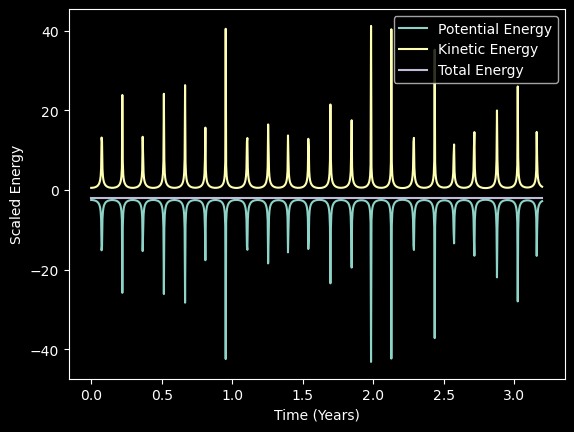

In [24]:
## Compute the potential energy of the system 

def calculate_potential(x1, y1, x2, y2, x3, y3, m1, m2, m3, G = 1):
    r12 = np.sqrt((x2-x1)**2 + (y2-y1)**2)
    r13 = np.sqrt((x3-x1)**2 + (y3-y1)**2)
    r23 = np.sqrt((x2-x3)**2 + (y2-y3)**2)
    return -G * (m1 * m2 / r12 + m1 * m3 / r13 + m2 * m3 / r23)

def calculate_kinetic(vx1, vy1, vx2, vy2, vx3, vy3, m1, m2, m3):
    return 0.5 * (m1 * (vx1**2 + vy1**2) + m2 * (vx2**2 + vy2**2) + m3 * (vx3**2 + vy3**2))

# Calculate energies
U = calculate_potential(x1, y1, x2, y2, x3, y3, m1, m2, m3)
K = calculate_kinetic(sol.y[6], sol.y[7], sol.y[8], sol.y[9], sol.y[10], sol.y[11], m1, m2, m3)
total_energy = U + K

tt = 1/np.sqrt(6.67e-11 * 1.99e30 / (1.5e11)**3 ) # seconds
tt = tt / (60*60 * 24* 365.25) * np.diff(t)[0] # per time step (in years)
T = tt * np.array([i for i in range(0, len(t))] ) 

# Plot energies
plt.style.use('dark_background')
plt.figure()
plt.plot(T, U, label='Potential Energy')
plt.plot(T, K, label='Kinetic Energy')
plt.plot(T, total_energy, label='Total Energy')
plt.xlabel('Time (Years)')
plt.ylabel('Scaled Energy')
plt.legend()
plt.show()


### Converting the solution to proper time and animating the result 

In [25]:
# Define the colors for the custom colormaps
colors1 = [(1, 1, 1, 0), (0.5, 0.5, 1, 3.6)]
colors2 = [(1, 1, 1, 0), (1, 0.3, 0, 1.2)]
colors3 = [(1, 1, 1, 0), (1, 1, 0.9, 1)]

# Create custom colormaps
cmap_name1 = 'custom_blue'
cmap1 = LinearSegmentedColormap.from_list(cmap_name1, colors1, N=256)
cmap_name2 = 'custom_orange'
cmap2 = LinearSegmentedColormap.from_list(cmap_name2, colors2, N=256)
cmap_name3 = 'custom_white'
cmap3 = LinearSegmentedColormap.from_list(cmap_name3, colors3, N=256)

# Center positions
center_x1, center_y1 = 0, 0
center_x2, center_y2 = 0, 0
center_x3, center_y3 = 0, 0

# Standard deviations
sigma_x = 0.04
sigma_y = 0.04

xmin, xmax = -2, 2
ymin, ymax = -2, 2

# Create a grid of points using Gaussian values and coloring to enact 'stars'
x, y = np.meshgrid(np.linspace(xmin, xmax, 500), np.linspace(ymin, ymax, 500))
r = np.sqrt((x - center_x1)**2 + (y - center_y1)**2)  # Radial distance
z = np.exp(-((x - center_x1)**2 / (2 * sigma_x**2) + (y - center_y1)**2 / (2 * sigma_y**2))) # Calculate the initial 2D Gaussian values
z[r > 3 * sigma_x] = np.nan # Mask values beyond 2.5 standard deviations

## Set up the figures
fig, ax = plt.subplots(1, 2, figsize=(16, 8))
# Set the first plot first 
ax[0].set_ylim(1.1 * min(U), max(K) * 1.1)  # Set y-axis limit for energy plot
ax[0].set_xlim(-0.1, max(T))  # Set initial x-axis limit for energy plot
ax[0].set_xlabel('Time (Years)') 
ax[0].set_ylabel('Scaled Energy')
line_U, = ax[0].plot([], [], label='Potential Energy')
line_K, = ax[0].plot([], [], label='Kinetic Energy')
line_total, = ax[0].plot([], [], label='Total Energy')
ax[0].legend()


max_limits_y = max(max(y1[:]), max(y2[:]), max(y3[:]))
min_limits_y = min(min(y1[:]), min(y2[:]), min(y3[:]))
max_limits_x = max(max(x1[:]), max(x2[:]), max(x3[:]))
min_limits_x = min(min(x1[:]), min(x2[:]), min(x3[:]))


# Set the second plot params
ax[1].set_ylim(-1 + min_limits_y, max_limits_y + 1)
ax[1].set_xlim(-1 + min_limits_x, max_limits_x + 1)
ax[1].set_xlabel('Astronomical units (AU)') 
ax[1].set_ylabel('AU') 
ln1 = ax[1].imshow(z, cmap=cmap1, extent=[min_limits_x, max_limits_x, min_limits_y, max_limits_y], origin='lower', zorder=3)
ln2 = ax[1].imshow(z, cmap=cmap2, extent=[min_limits_x, max_limits_x, min_limits_y, max_limits_y], origin='lower', zorder=3)
ln3 = ax[1].imshow(z, cmap=cmap3, extent=[min_limits_x, max_limits_x, min_limits_y, max_limits_y], origin='lower', zorder=3)

def animate_plot(fr):
    line_U.set_data(T[:fr], U[:fr])
    line_K.set_data(T[:fr], K[:fr])
    line_total.set_data(T[:fr], total_energy[:fr])
    
    # Update center positions based on the trajectories
    new_center_x1, new_center_y1 = x3[fr], y3[fr]
    new_center_x2, new_center_y2 = x2[fr], y2[fr]
    new_center_x3, new_center_y3 = x1[fr], y1[fr]
    
    # Update the Gaussian distributions based on the new center positions
    new_z1 = np.exp(-((x - new_center_x1)**2 / (2 * sigma_x**2) + (y - new_center_y1)**2 / (2 * sigma_y**2)))
    new_z2 = np.exp(-((x - new_center_x2)**2 / (2 * sigma_x**2) + (y - new_center_y2)**2 / (2 * sigma_y**2)))
    new_z3 = np.exp(-((x - new_center_x3)**2 / (2 * sigma_x**2) + (y - new_center_y3)**2 / (2 * sigma_y**2)))
    
    
    ln1.set_data(new_z1)
    ln2.set_data(new_z2) 
    ln3.set_data(new_z3)
    
    return line_U, line_K, line_total, ln1, ln2, ln3

ani_3body = animation.FuncAnimation(fig, animate_plot, frames= len(t), interval=45, blit=True)
ani_3body.save('plan.gif', writer='pillow', fps=35)

plt.close() # Prevents double display of the animation
# Display the animation in the notebook
HTML(ani_3body.to_jshtml())

Animation size has reached 21011360 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
